## This notebook was introduced to test using generators instead of loading data directly in arrays. Also evaluation by confusion matrices and visual evaluation of segmentation were added.

In [1]:
# Fix seeds for random numbers first!

seed_value=1

# 1. Set `PYTHONHASHSEED` environment variable at a fixed value
import os
os.environ['PYTHONHASHSEED']=str(seed_value)

# 2. Set `python` built-in pseudo-random generator at a fixed value
import random
random.seed(seed_value)

# 3. Set `numpy` pseudo-random generator at a fixed value
import numpy as np
np.random.seed(seed_value)

# 4. Set the `tensorflow` pseudo-random generator at a fixed value
import tensorflow as tf
tf.random.set_seed(seed_value)
# for later versions: 
# tf.compat.v1.set_random_seed(seed_value)

# 5. Configure a new global `tensorflow` session
from tensorflow.keras import backend as K
#session_conf = tensorflow.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
#sess = tensorflow.Session(graph=tf.get_default_graph(), config=session_conf)
#K.set_session(sess)
# for later versions:
session_conf = tf.compat.v1.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
tf.compat.v1.keras.backend.set_session(sess)

In [2]:
import sys
import cv2
import json
import PIL
from PIL import ImageOps, ImageDraw, ImageFont
from matplotlib import pyplot as plt
import matplotlib.cm as cm
from collections import Counter
from skimage.transform import resize
import sklearn
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay, jaccard_score, f1_score, make_scorer, confusion_matrix, accuracy_score, precision_score, recall_score, precision_recall_curve

In [3]:
# tensorflow imports
import mltb.keras
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.models import load_model, Model, Sequential
from tensorflow.keras.layers import Dropout, Conv2D, MaxPooling2D, GlobalMaxPooling2D, Dense, Flatten
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.applications import VGG19, VGG16, ResNet50, EfficientNetB7
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array

In [4]:
# check GPU support
!python --version
print("\nNum GPUs Available:", len(tf.config.experimental.list_physical_devices('GPU')))

Python 3.7.10

Num GPUs Available: 1


## Input Data

### The input data is structured as follows:
- Training data: 483 Images (120 Olivine)
- Validation data: 103 Images (25 Olivine - 22 polygone-labeled)
- Test data: 104 Images (26 Olivine - all polygone-labeled)

Total images: **690**

Olivine Ratio: 171/690 = **25%**

Double-Check if the data input folder has the following structure:
- thin_section_dataset
    - train
        - olivine
        - non-olivine
    - validation
        - olivine
        - non-olivine
    - test
        - olivine
        - non-olivine

In [5]:
olivine_folder = 'thin_section_dataset/test/olivine/'
non_olivine_folder = 'thin_section_dataset/test/non-olivine/'

In [6]:
class PrintCallbackLog(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        print(logs.keys())

In [7]:
class Metrics(tf.keras.callbacks.Callback):
    def __init__(self, valid_data_generator):
        super(Metrics, self).__init__()
        self.validation_data = valid_data_generator

    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        val_steps_per_epoch = np.math.ceil(self.validation_data.samples / self.validation_data.batch_size)
        
        predict = self.model.predict(self.validation_data, steps=val_steps_per_epoch)
        val_predict = [1 * (x[0]>=0.5) for x in predict]
        
        val_targ = self.validation_data.classes

        _val_f1 = f1_score(val_targ, val_predict, average='macro')
        _val_recall = recall_score(val_targ, val_predict, average='macro')
        _val_precision = precision_score(val_targ, val_predict, average='macro')

        logs['val_f1'] = _val_f1
        logs['val_recall'] = _val_recall
        logs['val_precision'] = _val_precision
        print(f" — val_f1: {_val_f1} — val_precision: {_val_precision} — val_recall: {_val_recall}")
        return

In [8]:
class JaccardScoreCallback(tf.keras.callbacks.Callback):
    """Computes the Jaccard score and logs the results to TensorBoard."""

    def __init__(self, model, valid_data_generator, log_dir):
        self.model = model
        self.validation_data = valid_data_generator
        self.keras_metric = tf.keras.metrics.Mean("jaccard_score")
        self.epoch = 0
        self.summary_writer = tf.summary.create_file_writer(os.path.join(log_dir, model.name))

    def on_epoch_end(self, batch, logs=None):
        self.epoch += 1
        self.keras_metric.reset_states()
        
        val_steps_per_epoch = np.math.ceil(self.validation_data.samples/self.validation_data.batch_size)
        
        predict = self.model.predict(self.validation_data, steps=val_steps_per_epoch)
        val_predict = [1 * (x[0]>=0.5) for x in predict]
        
        val_targ = self.validation_data.classes
        
        jaccard_value = jaccard_score(val_predict, val_targ, average=None)
        self.keras_metric.update_state(jaccard_value)
        self._write_metric(self.keras_metric.name, self.keras_metric.result().numpy().astype(float))

    def _write_metric(self, name, value):
        with self.summary_writer.as_default():
            tf.summary.scalar(name, value, step=self.epoch,)
            self.summary_writer.flush()

In [9]:
class F1_Metric(tf.keras.callbacks.Callback):
    def __init__(self, model, valid_data_generator, filepath):
        self.model = model
        self.validation_data = valid_data_generator
        self.file_path = filepath

    def on_train_begin(self, logs=None):
        self.val_f1s = []
        self.best_val_f1 = 0
        self.val_recalls = []
        self.val_precisions = []

    def on_epoch_end(self, epoch, logs=None):
        val_steps_per_epoch = np.math.ceil(self.validation_data.samples/self.validation_data.batch_size)
        predict = self.model.predict(self.validation_data, steps=val_steps_per_epoch)
        val_predict = [1 * (x[0]>=0.5) for x in predict]
        val_targ = self.validation_data.classes
        _val_f1 = f1_score(val_targ, val_predict)
        _val_recall = recall_score(val_targ, val_predict)
        _val_precision = precision_score(val_targ, val_predict)
        self.val_f1s.append(_val_f1)
        self.val_recalls.append(_val_recall)
        self.val_precisions.append(_val_precision)
        print('\n'+'*'*50)
        print(f"_val_f1: {_val_f1:.2f}, _val_precision: {_val_precision:.2f}, _val_recall: {_val_recall:.2f}")
        print("max f1")
        print(max(self.val_f1s))
        if _val_f1 > self.best_val_f1:
            self.model.save_weights(self.file_path, overwrite=True)
            self.best_val_f1 = _val_f1
            print(f"best f1: {self.best_val_f1:.2f}")
        else:
            print(f"val f1: {_val_f1:.2f}, but not the best f1")
        return

In [10]:
# define basic cnn model
def define_base_model(learn_rate=0.001):
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', input_shape=(224, 224, 3)))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.2))
    model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.2))
    model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', name='last_conv_layer'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.2))
    model.add(Flatten())
    model.add(Dense(128, activation='relu', kernel_initializer='he_uniform'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    
    # compile model
    # opt = SGD(lr=0.001, momentum=0.9)
    opt = Adam(learning_rate=learn_rate)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    return model

In [11]:
def define_test_model(input_shape=(224, 224, 3)):
    model = EfficientNetB7(include_top=False, input_shape=input_shape)
    for layer in model.layers:
        layer.trainable = False
    opt = Adam(learning_rate=0.001)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    return model

In [12]:
# define cnn model
def define_vgg_model(image_shape=(224, 224, 3), index=22):
    # load model
    model = VGG16(include_top=False, input_shape=image_shape)
    # mark loaded layers as not trainable
    for layer in model.layers:#[:index]:
        layer.trainable = False
    # add new classifier layers
    flat1 = Flatten()(model.layers[-1].output)
    class1 = Dense(128, activation='relu', kernel_initializer='he_uniform')(flat1)
    output = Dense(1, activation='sigmoid')(class1)
    # define new model
    model = Model(inputs=model.inputs, outputs=output)
    # compile model
    #opt = SGD(lr=0.001, momentum=0.9)
    opt = Adam(learning_rate=0.001)
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [13]:
def define_vgg_model_new(image_shape=(224, 224, 3), index=22):
    pretrained_model = VGG16(input_shape=image_shape, include_top=False, weights="imagenet")
    for layer in pretrained_model.layers:
        layer.trainable = False
    last_layer = pretrained_model.get_layer('block5_pool')
    last_output = last_layer.output
    x = GlobalMaxPooling2D()(last_output)
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.5)(x)
    x = Dense(2, activation='sigmoid')(x)
    model = tf.keras.Model(pretrained_model.input, x)
    opt = Adam(learning_rate=0.001)
    model.compile(optimizer=opt, loss=tf.keras.losses.sparse_categorical_crossentropy, metrics=['acc'])

    return model

In [14]:
def define_custom_vgg_model(image_shape=(224, 224, 3), index=22, learn_rate=0.001):
    base_model = VGG19(include_top = False, weights = 'imagenet', input_shape = image_shape)
    opt = Adam(learning_rate=learn_rate)
    
    for layer in base_model.layers[:index]:
        layer.trainable = False
    # base_model.trainable = False # freeze layers from pretrained model

    model = Sequential()
    #model = Model(inputs=base_model.input, outputs=base_model.layers[-1].output) # copy all layers from base_model
    model.add(Rescaling(1./255,input_shape = image_shape))
    for layer in base_model.layers[1:-1]: # loop through convolution layers
        model.add(layer)
    model.add(base_model.get_layer('block5_pool')) # add final maxpooling2D layer
    model.add(Flatten())
    model.add(Dense(256,activation=('relu'))) 
    model.add(Dropout(.2))
    model.add(Dense(128,activation=('relu')))
    model.add(Dropout(.2))
    
    # Final layer
    model.add(Dense(1,activation=('sigmoid'),name="activation_1"))
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [15]:
def define_resnet50_model(image_shape=(224, 224, 3)):
    # Fixed for our Cats & Dogs classes
    NUM_CLASSES = 2

    # Fixed for Cats & Dogs color images
    CHANNELS = 3

    IMAGE_RESIZE = 224
    RESNET50_POOLING_AVERAGE = 'avg'
    DENSE_LAYER_ACTIVATION = 'sigmoid'
    OBJECTIVE_FUNCTION = 'sparse_categorical_crossentropy'

    # Common accuracy metric for all outputs, but can use different metrics for different output
    LOSS_METRICS = ['accuracy']

    # EARLY_STOP_PATIENCE must be < NUM_EPOCHS
    NUM_EPOCHS = 10
    EARLY_STOP_PATIENCE = 3

    # These steps value should be proper FACTOR of no.-of-images in train & valid folders respectively
    # Training images processed in each step would be no.-of-train-images / STEPS_PER_EPOCH_TRAINING
    STEPS_PER_EPOCH_TRAINING = 10
    STEPS_PER_EPOCH_VALIDATION = 10

    # These steps value should be proper FACTOR of no.-of-images in train & valid folders respectively
    # NOTE that these BATCH* are for Keras ImageDataGenerator batching to fill epoch step input
    BATCH_SIZE_TRAINING = 100
    BATCH_SIZE_VALIDATION = 100

    # Using 1 to easily manage mapping between test_generator & prediction for submission preparation
    BATCH_SIZE_TESTING = 1
    
    resnet_weights_path = './resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5'
    weights = 'imagenet'
    
    #Still not talking about our train/test data or any pre-processing.

    model = Sequential()

    # 1st layer as the lumpsum weights from resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5
    # NOTE that this layer will be set below as NOT TRAINABLE, i.e., use it as is
    model.add(ResNet50(include_top = False, pooling = RESNET50_POOLING_AVERAGE, weights = weights))

    # 2nd layer as Dense for 2-class classification, i.e., dog or cat using SoftMax activation
    model.add(Dense(NUM_CLASSES, activation = DENSE_LAYER_ACTIVATION))

    # Say not to train first layer (ResNet) model as it is already trained
    model.layers[0].trainable = False
    
    sgd = SGD(lr = 0.01, decay = 1e-6, momentum = 0.9, nesterov = True)
    model.compile(optimizer = sgd, loss = OBJECTIVE_FUNCTION, metrics = LOSS_METRICS)
    
    return model

In [16]:
if not os.path.exists('./saved_models'):
    os.makedirs('./saved_models')
if not os.path.exists('./saved_models/checkpoints'):
    os.makedirs('./saved_models/checkpoints')
# Callback Definition
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint('./checkpoints/base_model_{epoch:02d}.h5',
                                                 monitor='val_loss', 
                                                 mode='auto', verbose=2,
                                                 save_best_only=True,
                                                 save_weights_only=True)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir='./saved_models/logs', profile_batch=0)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 50)

In [17]:
# run the test harness for evaluating a model
def run_test_harness(model_name='base', epochs=50, batch_size=32, index=22, verbose=1):
    # define model
    if model_name == 'base':
        model = define_base_model()
    elif model_name == 'test':
        model = define_test_model()
    elif model_name == 'vgg':
        model = define_vgg_model(index=index)
    elif model_name == 'custom_vgg':
        model = define_custom_vgg_model(index=index)
    elif model_name == 'resnet50':
        model = define_resnet50_model()
    
    # create data generators
    train_datagen = ImageDataGenerator(rescale=1.0/255.0,
                                       #rotation_range=40,
                                       #width_shift_range=0.2,
                                       #height_shift_range=0.2,
                                       #shear_range=0.2,
                                       #zoom_range=0.2,
                                       #brightness_range=[0.1,1],
                                       #horizontal_flip=True,
                                       #fill_mode='nearest'
                                      )
    
    val_datagen = ImageDataGenerator(rescale=1.0/255.0)
    
    # prepare iterators
    train_generator = train_datagen.flow_from_directory('thin_section_dataset/train/',
                                                 class_mode='binary',
                                                 color_mode='rgb',
                                                 batch_size=batch_size,
                                                 target_size=(224, 224))
    
    val_generator = val_datagen.flow_from_directory('thin_section_dataset/validation/',
                                               class_mode='binary', 
                                               color_mode='rgb',
                                               batch_size=batch_size, 
                                               target_size=(224, 224))
    
    # calculate class weights
    counter = Counter(train_generator.classes)
    max_val = float(max(counter.values()))
    class_weights = {class_id : max_val/num_images for class_id, num_images in counter.items()}
    
    ### Debug info ###
    print(f"\nClasses: {train_generator.class_indices}")
    print(f"Class Weights: {class_weights}")
    print(f"Class Distribution: {dict(counter)}\n")
    # fit model
    history = model.fit(train_generator, 
                        steps_per_epoch=len(train_generator), 
                        validation_data=val_generator, 
                        validation_steps=len(val_generator),
                        class_weight=class_weights,
                        epochs=epochs, 
                        verbose=verbose,
                        callbacks=[
                            #F1_Metric(model, val_generator, './saved_models/checkpoints/'),
                            #JaccardScoreCallback(model, val_generator, './saved_models/logs'),
                            Metrics(valid_data_generator=val_generator),
                            checkpoint_callback,
                            early_stopping,
                            PrintCallbackLog(),
                            #tensorboard_callback,
                        ])
    
    return model, history

In [18]:
# plot diagnostic learning curves
def summarize_diagnostics(history):
    # plot loss
    plt.subplot(211)
    plt.title('Cross Entropy Loss')
    plt.plot(history.history['loss'], color='blue')
    plt.plot(history.history['val_loss'], color='orange')
    plt.legend(['train', 'val'])
    
    # plot accuracy
    plt.subplot(212)
    plt.title('Classification Accuracy')
    plt.plot(history.history['accuracy'], color='blue')
    plt.plot(history.history['val_accuracy'], color='orange')
    plt.legend(['train', 'val']) 
    
    plt.subplots_adjust(top=1.6, right=1.2)
    
    plt.show()

In [19]:
def show_confusion_matrix(model, test_generator, batch_divisor=1):    
    test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)

    predictions = model.predict(test_generator, steps=test_steps_per_epoch)
    predicted_classes = [1 * (x[0]>=0.5) for x in predictions]
    
    true_classes = test_generator.classes
    class_labels = list(test_generator.class_indices.keys()) 
    
    cm = confusion_matrix(true_classes, predicted_classes)
    
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
    
    disp.plot(cmap=plt.cm.Blues)
    plt.show()
    
    report = sklearn.metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
    print(report) 

In [20]:
def evaluate_model(model, history, verbose=1):
    test_datagen = ImageDataGenerator(rescale=1.0/255.0)
    test_generator = test_datagen.flow_from_directory('thin_section_dataset/test/',
                                               class_mode='binary',
                                               color_mode='rgb',
                                               target_size=(224, 224),
                                               batch_size=1,
                                               shuffle=False,)
    # calculate test set accuracy
    _, acc = model.evaluate(test_generator, steps=len(test_generator), verbose=1)
    print('\nAccuracy on test set: %.3f' % (acc * 100.0))
    
    if verbose:
        # plot learning curves
        summarize_diagnostics(history)

        # plot confusion matrix
        show_confusion_matrix(model, test_generator)
    
    return acc

In [21]:
def load_image(img_path, show=True):

    img = image.load_img(img_path, target_size=(224, 224))
    img_tensor = image.img_to_array(img)                    # (height, width, channels)
    img_tensor = np.expand_dims(img_tensor, axis=0)         # (1, height, width, channels), add a dimension because the model expects this shape: (batch_size, height, width, channels)
    img_tensor /= 255.                                      # imshow expects values in the range [0, 1]

    if show:
        plt.imshow(img_tensor[0])                           
        plt.axis('off')
        plt.show()

    return img_tensor # np.array()

In [22]:
def show_img(img):
    #Show the image with matplotlib
    plt.imshow(img)
    plt.show()

In [23]:
def show_prediction(img_path, model):
    print(img_path)
    # load a single image
    new_image = load_image(img_path)

    # check prediction
    pred = model.predict(new_image)
    
    
    if pred[0][0] < 0.5:
        label = 'Non-Olivine'
    else:
        label = 'Olivine'
    print(f'Prediction class: {label}, Softmax value: %.2f' % pred[0][0])
    print('*'*50)

In [24]:
def predict_images(input_folder, model):
    directory = os.fsencode(input_folder)
    
    for file in os.listdir(directory):
        filename = os.fsdecode(file)
        show_prediction(input_folder + filename, model)

# Stop


# # #

# # #

# # #

In [155]:
# base cnn model
base_model, base_history = run_test_harness(model_name='base', batch_size=32, epochs=30, verbose=1)

Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/30
16/16 [==============================] - ETA: 0s - loss: 15.5357 - accuracy: 0.5673 — val_f1: 0.4626805778491172 — val_precision: 0.5466666666666666 — val_recall: 0.5071794871794871

Epoch 00001: val_loss did not improve from 0.59234
dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy', 'val_f1', 'val_recall', 'val_precision'])
16/16 [==============================] - 4s 247ms/step - loss: 15.5357 - accuracy: 0.5673 - val_loss: 0.6669 - val_accuracy: 0.7476
Epoch 2/30
15/16 [===========================>..] - ETA: 0s - loss: 0.9655 - accuracy: 0.6583 — val_f1: 0.3966364323507181 — val_precision: 0.5066210045662101 — val_recall: 0.5074358974358975

Epoch 00002: val_loss did not improve from 0.59234
dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy', 'val_f1', 'val_recall'

KeyboardInterrupt: 

Found 104 images belonging to 2 classes.
104/104 [==============================] - 1s 9ms/step - loss: 2.1204 - accuracy: 0.7115

Accuracy on test set: 71.154


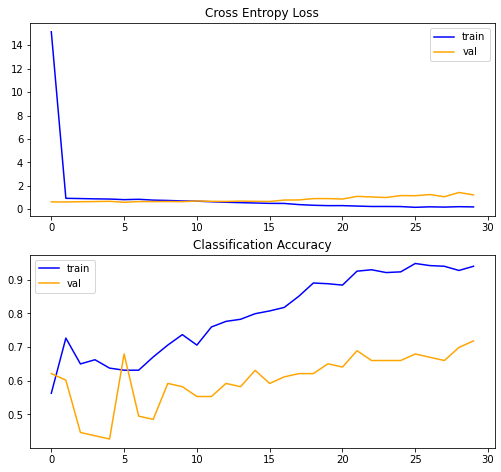

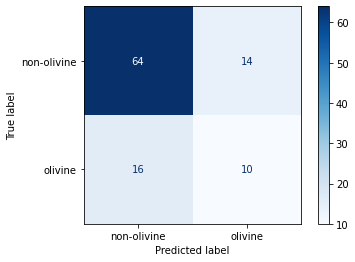

              precision    recall  f1-score   support

 non-olivine       0.80      0.82      0.81        78
     olivine       0.42      0.38      0.40        26

    accuracy                           0.71       104
   macro avg       0.61      0.60      0.61       104
weighted avg       0.70      0.71      0.71       104



In [184]:
# load best model
base_model = load_model('saved_models/base_model_0.5200_.h5')
accuracy = evaluate_model(base_model, base_history)

In [22]:
# 10 iterations of training of base model
acc_list = []
for i in range(10):
    # base cnn model
    print(f"Run #No. {i+1}")
    base_model, base_history = run_test_harness(model_name='base', batch_size=32, epochs=30, verbose=2)
    accuracy = evaluate_model(base_model, base_history, verbose=0)
    acc_list.append(accuracy)

Run #No. 1
Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/30
16/16 - 8s - loss: 28.0269 - accuracy: 0.5880 - val_loss: 0.6611 - val_accuracy: 0.5049
Epoch 2/30
16/16 - 8s - loss: 1.0070 - accuracy: 0.6749 - val_loss: 0.6359 - val_accuracy: 0.5437
Epoch 3/30
16/16 - 8s - loss: 0.9469 - accuracy: 0.7308 - val_loss: 0.6176 - val_accuracy: 0.4951
Epoch 4/30
16/16 - 8s - loss: 0.9504 - accuracy: 0.6625 - val_loss: 0.6383 - val_accuracy: 0.4757
Epoch 5/30
16/16 - 8s - loss: 0.9155 - accuracy: 0.6625 - val_loss: 0.6801 - val_accuracy: 0.4175
Epoch 6/30
16/16 - 13s - loss: 0.9603 - accuracy: 0.5735 - val_loss: 0.7395 - val_accuracy: 0.3786
Epoch 7/30
16/16 - 8s - loss: 0.9929 - accuracy: 0.5839 - val_loss: 0.6471 - val_accuracy: 0.5340
Epoch 8/30
16/16 - 8s - loss: 0.9341 - accuracy: 0.6708 - val_loss: 0.6545 - val_accuracy: 0.4078
Epoch 

104/104 [==============================] - 1s 6ms/step - loss: 0.6178 - accuracy: 0.7404

Accuracy on test set: 74.038
Run #No. 4
Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/30
16/16 - 13s - loss: 11.1556 - accuracy: 0.6066 - val_loss: 0.6273 - val_accuracy: 0.7573
Epoch 2/30
16/16 - 8s - loss: 1.0191 - accuracy: 0.7453 - val_loss: 0.6408 - val_accuracy: 0.6408
Epoch 3/30
16/16 - 8s - loss: 0.9828 - accuracy: 0.7474 - val_loss: 0.5972 - val_accuracy: 0.6214
Epoch 4/30
16/16 - 9s - loss: 0.9781 - accuracy: 0.6770 - val_loss: 0.6373 - val_accuracy: 0.4272
Epoch 5/30
16/16 - 8s - loss: 0.9959 - accuracy: 0.6646 - val_loss: 0.6168 - val_accuracy: 0.4660
Epoch 6/30
16/16 - 8s - loss: 0.9543 - accuracy: 0.5983 - val_loss: 0.6332 - val_accuracy: 0.5728
Epoch 7/30
16/16 - 8s - loss: 0.9361 - accuracy: 0.7081 - val_loss: 0.6271 - val_ac

104/104 [==============================] - 1s 5ms/step - loss: 0.5743 - accuracy: 0.6635

Accuracy on test set: 66.346
Run #No. 7
Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/30
16/16 - 8s - loss: 20.0907 - accuracy: 0.5176 - val_loss: 0.6427 - val_accuracy: 0.7573
Epoch 2/30
16/16 - 8s - loss: 1.0304 - accuracy: 0.7433 - val_loss: 0.6278 - val_accuracy: 0.7573
Epoch 3/30
16/16 - 13s - loss: 0.9720 - accuracy: 0.7308 - val_loss: 0.5974 - val_accuracy: 0.6990
Epoch 4/30
16/16 - 8s - loss: 1.0016 - accuracy: 0.7060 - val_loss: 0.6337 - val_accuracy: 0.5049
Epoch 5/30
16/16 - 8s - loss: 0.9839 - accuracy: 0.6894 - val_loss: 0.6287 - val_accuracy: 0.4854
Epoch 6/30
16/16 - 8s - loss: 0.9714 - accuracy: 0.6625 - val_loss: 0.6144 - val_accuracy: 0.5049
Epoch 7/30
16/16 - 8s - loss: 0.9487 - accuracy: 0.5901 - val_loss: 0.6190 - val_ac

104/104 [==============================] - 1s 6ms/step - loss: 0.6491 - accuracy: 0.6442

Accuracy on test set: 64.423
Run #No. 10
Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/30
16/16 - 9s - loss: 25.0988 - accuracy: 0.5901 - val_loss: 0.6474 - val_accuracy: 0.5049
Epoch 2/30
16/16 - 9s - loss: 0.9766 - accuracy: 0.7226 - val_loss: 0.6178 - val_accuracy: 0.6019
Epoch 3/30
16/16 - 8s - loss: 0.9217 - accuracy: 0.7081 - val_loss: 0.6107 - val_accuracy: 0.5437
Epoch 4/30
16/16 - 9s - loss: 0.9274 - accuracy: 0.6460 - val_loss: 0.6208 - val_accuracy: 0.5243
Epoch 5/30
16/16 - 14s - loss: 0.9659 - accuracy: 0.6687 - val_loss: 0.6663 - val_accuracy: 0.4660
Epoch 6/30
16/16 - 8s - loss: 0.9714 - accuracy: 0.5797 - val_loss: 0.6938 - val_accuracy: 0.3689
Epoch 7/30
16/16 - 8s - loss: 0.9287 - accuracy: 0.6232 - val_loss: 0.6513 - val_a

In [23]:
# mean and std of base model training
mean = np.mean(acc_list)
std = np.std(acc_list)
print(f"Model analysis:\nMeasured accuracies: {acc_list}\nMean: {mean}\nStD: {std}")

Model analysis:
Measured accuracies: [0.6346153616905212, 0.5769230723381042, 0.7403846383094788, 0.6634615659713745, 0.6153846383094788, 0.6634615659713745, 0.5865384340286255, 0.6442307829856873, 0.6442307829856873, 0.6634615659713745]
Mean: 0.6432692408561707
StD: 0.04373680227663483


thin_section_dataset/test/olivine/12004_r2_olivine_basalt_OLV.jpg


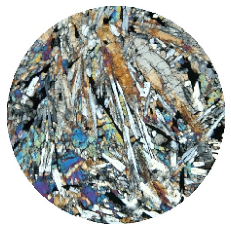

Prediction class: Olivine, Softmax value: 0.53
**************************************************
thin_section_dataset/test/olivine/12015_r1_olivine_vitrophyre_OLV.jpg


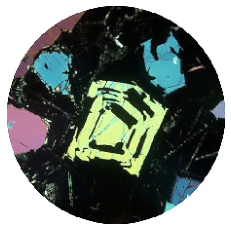

Prediction class: Non-Olivine, Softmax value: 0.14
**************************************************
thin_section_dataset/test/olivine/12015_r2_olivine_vitrophyre_OLV.jpg


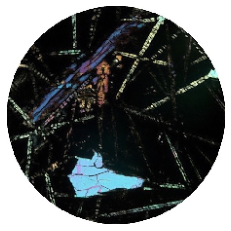

Prediction class: Non-Olivine, Softmax value: 0.04
**************************************************
thin_section_dataset/test/olivine/12040_r2_olivine_basalt_OLV.jpg


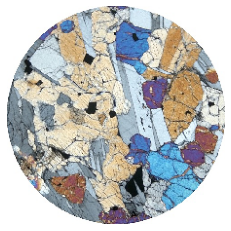

Prediction class: Olivine, Softmax value: 0.65
**************************************************
thin_section_dataset/test/olivine/12076_r2_olivine_basalt_OLV.jpg


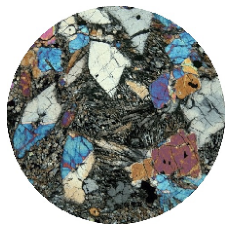

Prediction class: Olivine, Softmax value: 0.57
**************************************************
thin_section_dataset/test/olivine/14066_r2_crystalline_breccia_OLV.jpg


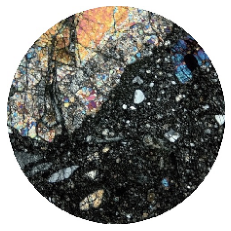

Prediction class: Non-Olivine, Softmax value: 0.26
**************************************************
thin_section_dataset/test/olivine/14305_r2_polymict_breccia_OLV.jpg


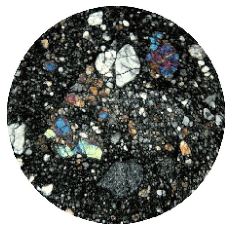

Prediction class: Non-Olivine, Softmax value: 0.19
**************************************************
thin_section_dataset/test/olivine/15016_r1_vesicular_olivine_basalt_OLV.jpg


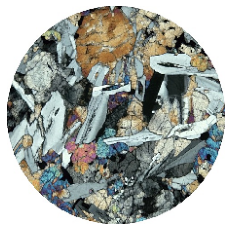

Prediction class: Non-Olivine, Softmax value: 0.47
**************************************************
thin_section_dataset/test/olivine/15065_r1_pigeonite_basalt_OLV.jpg


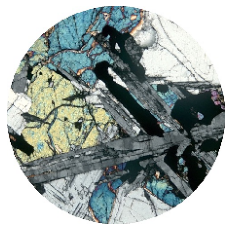

Prediction class: Non-Olivine, Softmax value: 0.39
**************************************************
thin_section_dataset/test/olivine/15105_r2_olivine_phyric_basalt_OLV.jpg


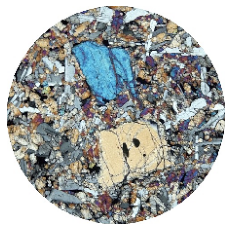

Prediction class: Olivine, Softmax value: 0.63
**************************************************
thin_section_dataset/test/olivine/15356_r1_impact_melt_OLV.jpg


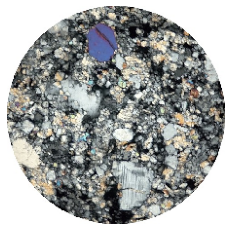

Prediction class: Olivine, Softmax value: 0.55
**************************************************
thin_section_dataset/test/olivine/15379_r1_shocked_olivine_basalt_OLV.jpg


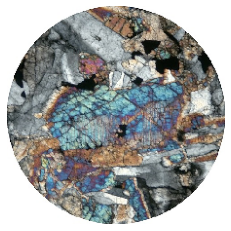

Prediction class: Olivine, Softmax value: 0.57
**************************************************
thin_section_dataset/test/olivine/15556_r1_vesicular_olivine_basalt_OLV.jpg


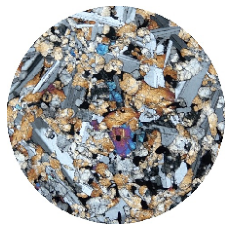

Prediction class: Olivine, Softmax value: 0.53
**************************************************
thin_section_dataset/test/olivine/15558_r1_regolith_breccia_OLV.jpg


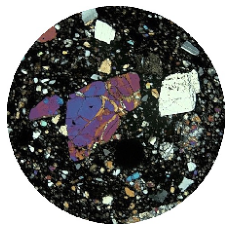

Prediction class: Non-Olivine, Softmax value: 0.11
**************************************************
thin_section_dataset/test/olivine/15610_r1_coarse_olivine_basalt_OLV.jpg


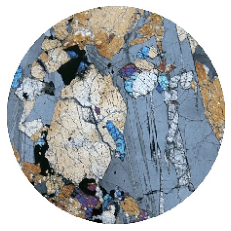

Prediction class: Olivine, Softmax value: 0.62
**************************************************
thin_section_dataset/test/olivine/15614_r1_vesicular_olivine_basalt_OLV.jpg


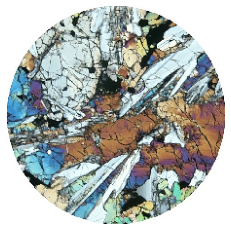

Prediction class: Olivine, Softmax value: 0.57
**************************************************
thin_section_dataset/test/olivine/15623_r1_vesicular_olivine_basalt_OLV.jpg


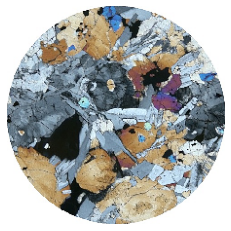

Prediction class: Olivine, Softmax value: 0.59
**************************************************
thin_section_dataset/test/olivine/15623_r2_vesicular_olivine_basalt_OLV.jpg


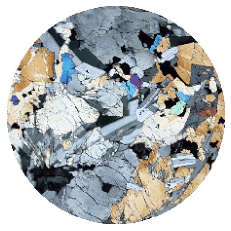

Prediction class: Olivine, Softmax value: 0.58
**************************************************
thin_section_dataset/test/olivine/15636_r2_olivine_basalt_OLV.jpg


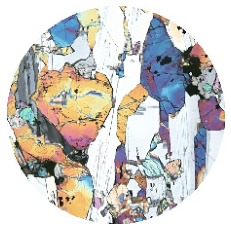

Prediction class: Olivine, Softmax value: 0.63
**************************************************
thin_section_dataset/test/olivine/15641_r2_coarse_olivine_basalt_OLV.jpg


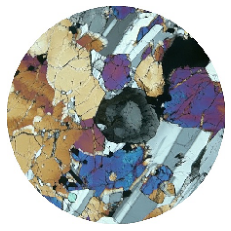

Prediction class: Olivine, Softmax value: 0.65
**************************************************
thin_section_dataset/test/olivine/15643_r2_coarse_olivine_basalt_OLV.jpg


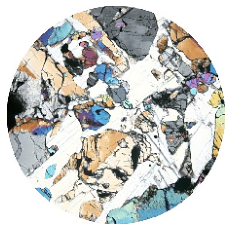

Prediction class: Olivine, Softmax value: 0.55
**************************************************
thin_section_dataset/test/olivine/15663_r2_coarse_olivine_basalt_OLV.jpg


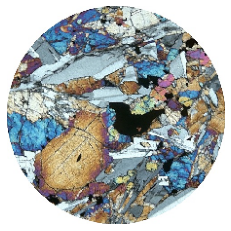

Prediction class: Olivine, Softmax value: 0.61
**************************************************
thin_section_dataset/test/olivine/15665_r2_olivine_basalt_OLV.jpg


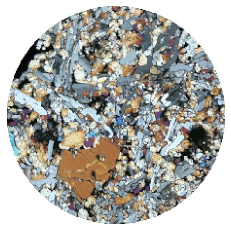

Prediction class: Olivine, Softmax value: 0.52
**************************************************
thin_section_dataset/test/olivine/67016_r1_immature_feldspathic_regolith_breccia_OLV.jpg


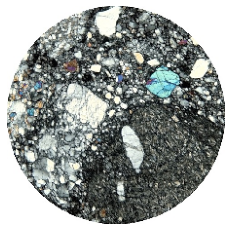

Prediction class: Non-Olivine, Softmax value: 0.50
**************************************************
thin_section_dataset/test/olivine/rbt04262_r1_Martian_meteorites_pyroxene_olivine_maskelynite_glass_OLV.jpg


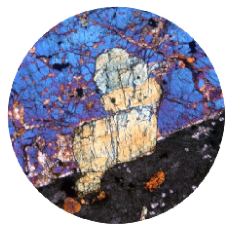

Prediction class: Olivine, Softmax value: 0.81
**************************************************
thin_section_dataset/test/olivine/smg117_r1_peridotite_olivine_pyroxene_chromite_plagioclase_feldspar_OLV.jpg


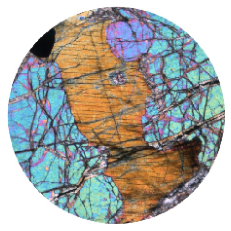

Prediction class: Olivine, Softmax value: 0.67
**************************************************


In [131]:
predict_images(olivine_folder, base_model)

thin_section_dataset/test/non-olivine/10018_r1_regolith_breccia_NOLV.jpg


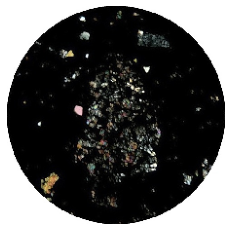

Prediction class: Non-Olivine, Softmax value: 0.03
**************************************************
thin_section_dataset/test/non-olivine/10022_r1_ilmenite_basalt_NOLV.jpg


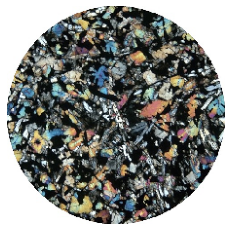

Prediction class: Non-Olivine, Softmax value: 0.37
**************************************************
thin_section_dataset/test/non-olivine/10031_r1_high_k_ilmenite_basalt_NOLV.jpg


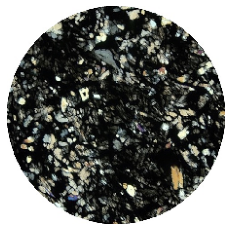

Prediction class: Non-Olivine, Softmax value: 0.02
**************************************************
thin_section_dataset/test/non-olivine/10032_r2_ilmenite_basalt_NOLV.jpg


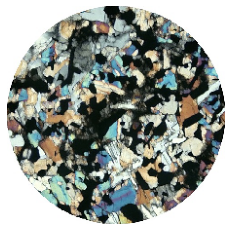

Prediction class: Non-Olivine, Softmax value: 0.28
**************************************************
thin_section_dataset/test/non-olivine/10045_r2_ilmenite_basalt_NOLV.jpg


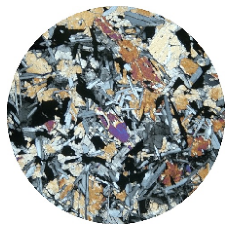

Prediction class: Non-Olivine, Softmax value: 0.47
**************************************************
thin_section_dataset/test/non-olivine/10046_r2_basaltic_regolith_breccia_NOLV.jpg


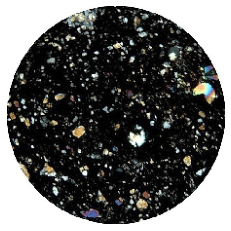

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/10048_r1_grey_regolith_breccia_NOLV.jpg


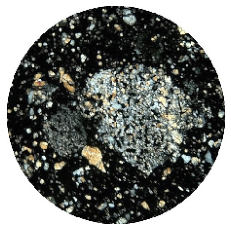

Prediction class: Non-Olivine, Softmax value: 0.05
**************************************************
thin_section_dataset/test/non-olivine/10048_r2_grey_regolith_breccia_NOLV.jpg


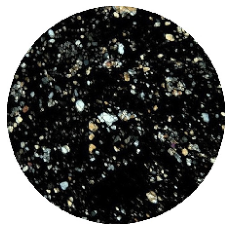

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/10050_r1_coarse_grained_ilmenite_basalt_NOLV.jpg


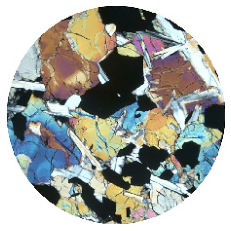

Prediction class: Non-Olivine, Softmax value: 0.40
**************************************************
thin_section_dataset/test/non-olivine/10058_r1_coarse_grained_ilmenite_basalt_NOLV.jpg


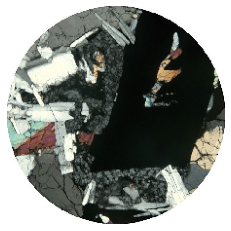

Prediction class: Non-Olivine, Softmax value: 0.25
**************************************************
thin_section_dataset/test/non-olivine/10065_r2_regolith_breccia_NOLV.jpg


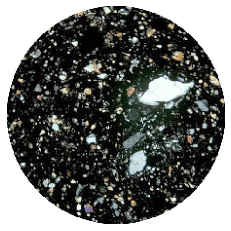

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/10070_r1_regolith_breccia_NOLV.jpg


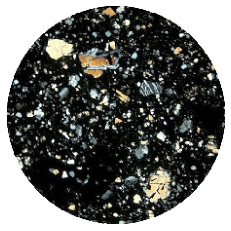

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/10071_r2_high_ti_basalt_NOLV.jpg


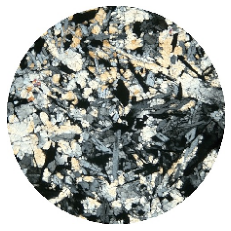

Prediction class: Non-Olivine, Softmax value: 0.35
**************************************************
thin_section_dataset/test/non-olivine/10082_r2_regolith_breccia_NOLV.jpg


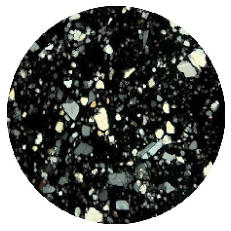

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/10085_r2_coarse_grained_basalt_NOLV.jpg


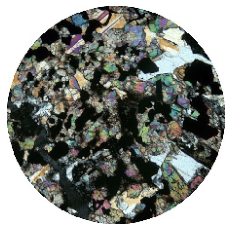

Prediction class: Non-Olivine, Softmax value: 0.27
**************************************************
thin_section_dataset/test/non-olivine/12013_r1_breccia_granite_NOLV.jpg


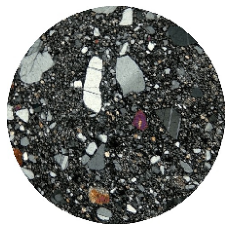

Prediction class: Non-Olivine, Softmax value: 0.37
**************************************************
thin_section_dataset/test/non-olivine/12013_r2_breccia_granite_NOLV.jpg


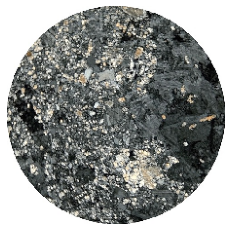

Prediction class: Non-Olivine, Softmax value: 0.46
**************************************************
thin_section_dataset/test/non-olivine/12036_r2_olivine_basalt_NOLV.jpg


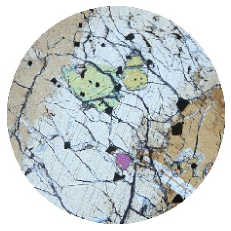

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/12047_r2_ilmenite_basalt_NOLV.jpg


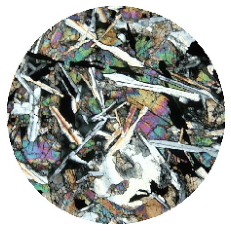

Prediction class: Non-Olivine, Softmax value: 0.46
**************************************************
thin_section_dataset/test/non-olivine/12055_r2_pigeonite_basalt_NOLV.jpg


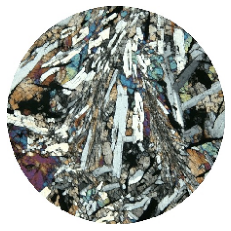

Prediction class: Non-Olivine, Softmax value: 0.49
**************************************************
thin_section_dataset/test/non-olivine/12061_r1_ilmenite_basalt_NOLV.jpg


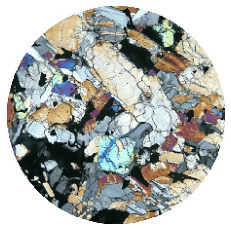

Prediction class: Olivine, Softmax value: 0.51
**************************************************
thin_section_dataset/test/non-olivine/12061_r2_ilmenite_basalt_NOLV.jpg


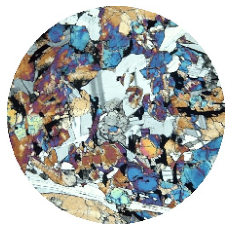

Prediction class: Olivine, Softmax value: 0.67
**************************************************
thin_section_dataset/test/non-olivine/12065_r2_pigeonite_basalt_NOLV.jpg


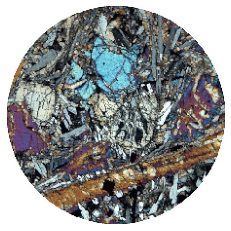

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/12073_r2_regolith_breccia_NOLV.jpg


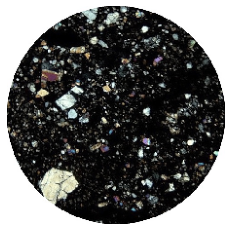

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/14041_r1_regolith_breccia_NOLV.jpg


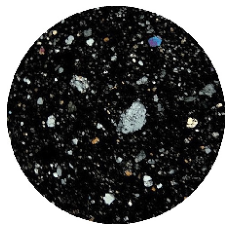

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/14047_r1_regolith_breccia_NOLV.jpg


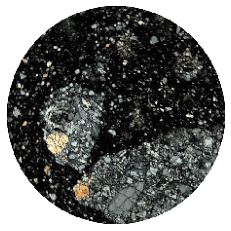

Prediction class: Non-Olivine, Softmax value: 0.02
**************************************************
thin_section_dataset/test/non-olivine/14047_r2_regolith_breccia_NOLV.jpg


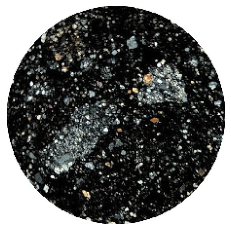

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/14055_r2_regolith_breccia_NOLV.jpg


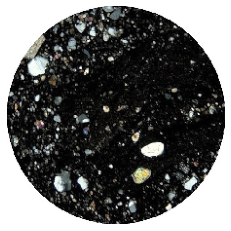

Prediction class: Non-Olivine, Softmax value: 0.02
**************************************************
thin_section_dataset/test/non-olivine/14063_r1_light_matrix_breccia_NOLV.jpg


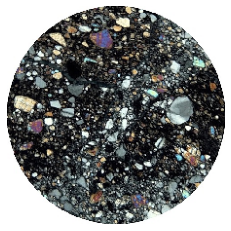

Prediction class: Non-Olivine, Softmax value: 0.20
**************************************************
thin_section_dataset/test/non-olivine/14070_r1_crystalline_breccia_NOLV.jpg


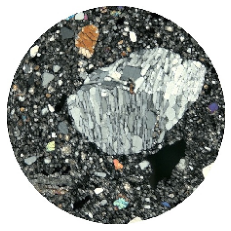

Prediction class: Non-Olivine, Softmax value: 0.46
**************************************************
thin_section_dataset/test/non-olivine/14073_r2_basalt_NOLV.jpg


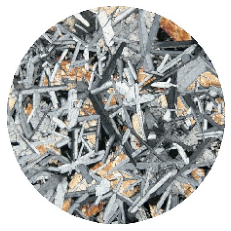

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/14077_r2_basalt_NOLV.jpg


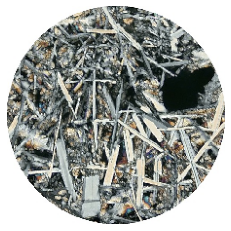

Prediction class: Non-Olivine, Softmax value: 0.47
**************************************************
thin_section_dataset/test/non-olivine/14179_r1_breccia_clasts_NOLV.jpg


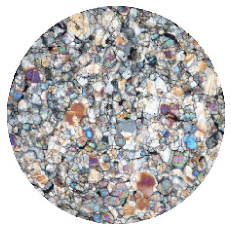

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/14255_r1_regolith_breccia_NOLV.jpg


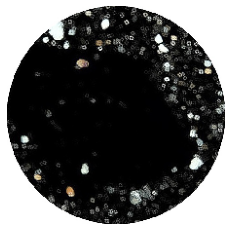

Prediction class: Non-Olivine, Softmax value: 0.04
**************************************************
thin_section_dataset/test/non-olivine/14274_r1_crystalline_matrix_breccia_NOLV.jpg


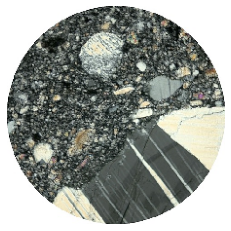

Prediction class: Olivine, Softmax value: 0.52
**************************************************
thin_section_dataset/test/non-olivine/14310_r1_impact_melt_breccia_NOLV.jpg


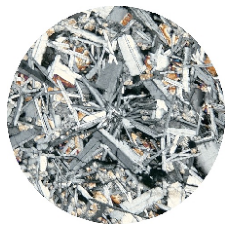

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/14311_r2_impact_melt_breccia_NOLV.jpg


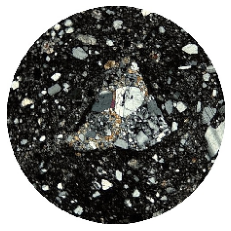

Prediction class: Non-Olivine, Softmax value: 0.07
**************************************************
thin_section_dataset/test/non-olivine/14316_r2_unusual_regolith_breccia_NOLV.jpg


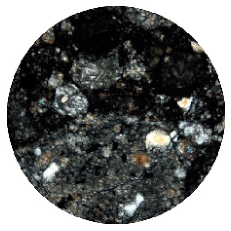

Prediction class: Non-Olivine, Softmax value: 0.19
**************************************************
thin_section_dataset/test/non-olivine/14320_r2_crystalline_matrix_breccia_NOLV.jpg


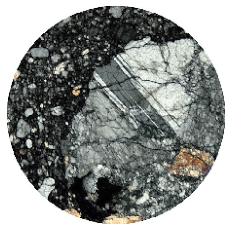

Prediction class: Non-Olivine, Softmax value: 0.37
**************************************************
thin_section_dataset/test/non-olivine/15065_r2_pigeonite_basalt_NOLV.jpg


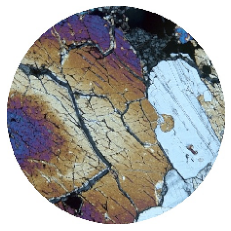

Prediction class: Olivine, Softmax value: 0.61
**************************************************
thin_section_dataset/test/non-olivine/15076_r1_pigeonite_basalt_NOLV.jpg


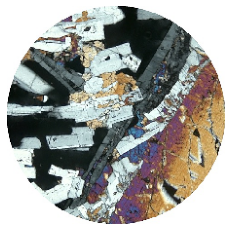

Prediction class: Non-Olivine, Softmax value: 0.44
**************************************************
thin_section_dataset/test/non-olivine/15095_r2_glass_covered_breccia_NOLV.jpg


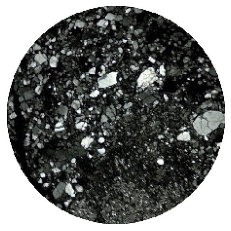

Prediction class: Non-Olivine, Softmax value: 0.08
**************************************************
thin_section_dataset/test/non-olivine/15265_r1_regolith_breccia_NOLV.jpg


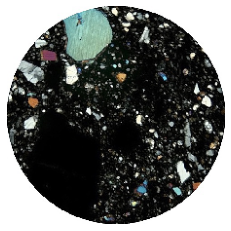

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/15285_r2_regolith_breccia_NOLV.jpg


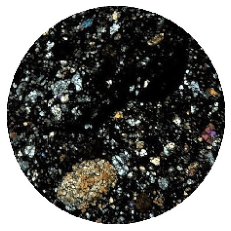

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/15286_r2_regolith_breccia_NOLV.jpg


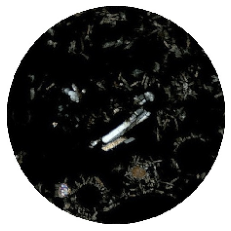

Prediction class: Non-Olivine, Softmax value: 0.08
**************************************************
thin_section_dataset/test/non-olivine/15295_r1_regolith_breccia_NOLV.jpg


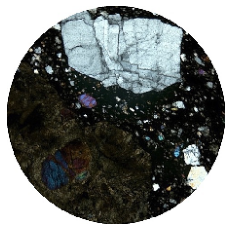

Prediction class: Non-Olivine, Softmax value: 0.09
**************************************************
thin_section_dataset/test/non-olivine/15298_r2_regolith_breccia_NOLV.jpg


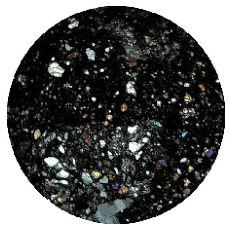

Prediction class: Non-Olivine, Softmax value: 0.02
**************************************************
thin_section_dataset/test/non-olivine/15325_r1_regolith_breccia_NOLV.jpg


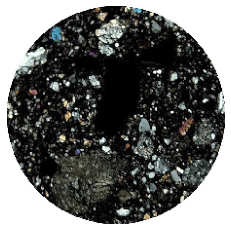

Prediction class: Non-Olivine, Softmax value: 0.02
**************************************************
thin_section_dataset/test/non-olivine/15330_r2_regolith_breccia_NOLV.jpg


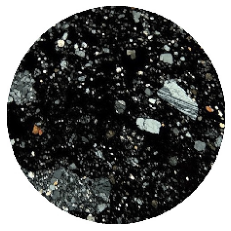

Prediction class: Non-Olivine, Softmax value: 0.00
**************************************************
thin_section_dataset/test/non-olivine/15371_r1_green_volcanic_glass_NOLV.jpg


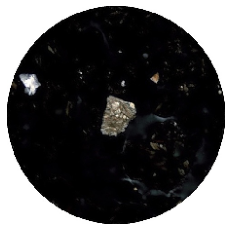

Prediction class: Non-Olivine, Softmax value: 0.18
**************************************************
thin_section_dataset/test/non-olivine/15371_r2_green_volcanic_glass_NOLV.jpg


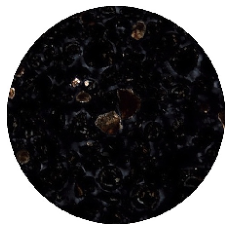

Prediction class: Non-Olivine, Softmax value: 0.14
**************************************************
thin_section_dataset/test/non-olivine/15405_r2_impact_melt_breccia_NOLV.jpg


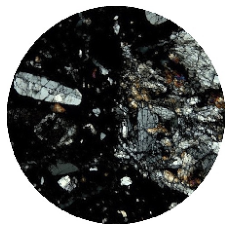

Prediction class: Non-Olivine, Softmax value: 0.09
**************************************************
thin_section_dataset/test/non-olivine/15415_r1_ferroan_anorthosite_NOLV.jpg


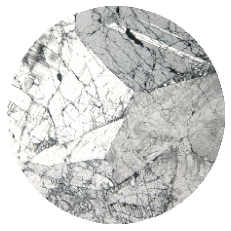

Prediction class: Olivine, Softmax value: 0.53
**************************************************
thin_section_dataset/test/non-olivine/15418_r2_heavily_shocked_granulite_NOLV.jpg


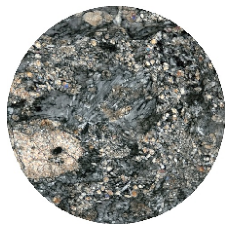

Prediction class: Olivine, Softmax value: 0.53
**************************************************
thin_section_dataset/test/non-olivine/15426_r1_green_glass_clods_NOLV.jpg


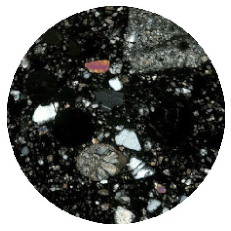

Prediction class: Non-Olivine, Softmax value: 0.10
**************************************************
thin_section_dataset/test/non-olivine/15465_r2_glass_breccia_clasts_NOLV.jpg


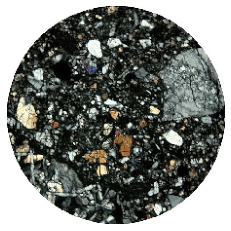

Prediction class: Non-Olivine, Softmax value: 0.11
**************************************************
thin_section_dataset/test/non-olivine/15476_r2_porphyritic_pigeonite_basalt_NOLV.jpg


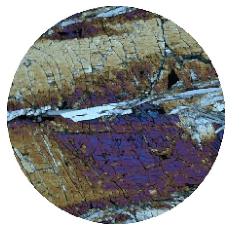

Prediction class: Olivine, Softmax value: 0.67
**************************************************
thin_section_dataset/test/non-olivine/15546_r1_coarse_grained_olivine_basalt_NOLV.jpg


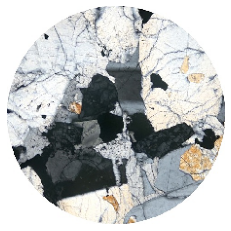

Prediction class: Non-Olivine, Softmax value: 0.48
**************************************************
thin_section_dataset/test/non-olivine/15565_r2_regolith_breccia_NOLV.jpg


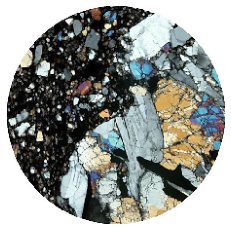

Prediction class: Non-Olivine, Softmax value: 0.17
**************************************************
thin_section_dataset/test/non-olivine/15596_r1_vuggy_vitrophyric_pigeonite_basalt_NOLV.jpg


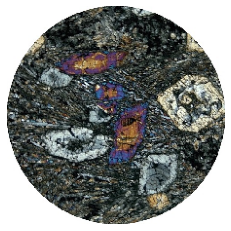

Prediction class: Non-Olivine, Softmax value: 0.44
**************************************************
thin_section_dataset/test/non-olivine/60025_r2_anorthosite_cataclasite_NOLV.jpg


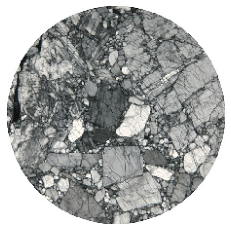

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/68501_r2_highland_regolith_soil_NOLV.jpg


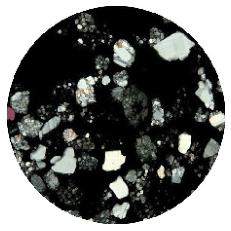

Prediction class: Non-Olivine, Softmax value: 0.03
**************************************************
thin_section_dataset/test/non-olivine/70181_r1_mature_mare_regolith_NOLV.jpg


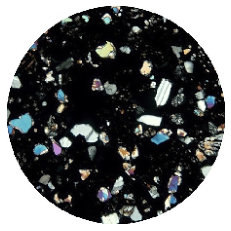

Prediction class: Non-Olivine, Softmax value: 0.01
**************************************************
thin_section_dataset/test/non-olivine/71035_r2_high_titanium_basalt_NOLV.jpg


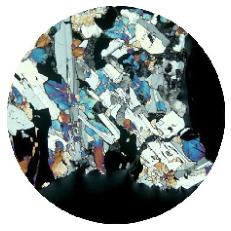

Prediction class: Non-Olivine, Softmax value: 0.27
**************************************************
thin_section_dataset/test/non-olivine/angeles_r1_basaltic_shergottite_pyroxene_maskelynite_glass_olivine_titanomagnetite_NOLV.jpg


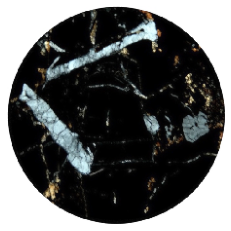

Prediction class: Non-Olivine, Softmax value: 0.09
**************************************************
thin_section_dataset/test/non-olivine/barwell_r1_l6_olivine_pyroxene_troilite_metallic_iron_NOLV.jpg


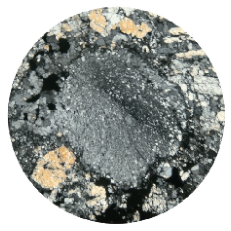

Prediction class: Non-Olivine, Softmax value: 0.50
**************************************************
thin_section_dataset/test/non-olivine/du9873_r1_basalt_olivine_pyroxene_plagioclase_feldspar_iron_oxide_NOLV.jpg


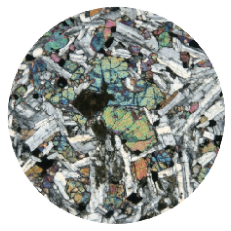

Prediction class: Olivine, Softmax value: 0.51
**************************************************
thin_section_dataset/test/non-olivine/eucrite1_r1_gabbro_olivine_pyroxene_plagioclase_feldspar_iron_oxide_NOLV.jpg


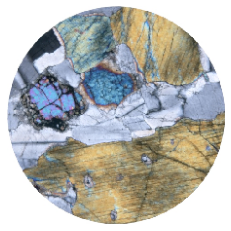

Prediction class: Olivine, Softmax value: 0.68
**************************************************
thin_section_dataset/test/non-olivine/glatton_r1_l6_olivine_pyroxene_troilite_metallic_iron_NOLV.jpg


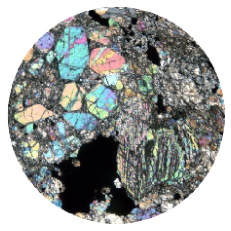

Prediction class: Non-Olivine, Softmax value: 0.48
**************************************************
thin_section_dataset/test/non-olivine/pontlyfni_r2_Winonaite_olivine_pyroxene_troilite_metallic_iron_NOLV.jpg


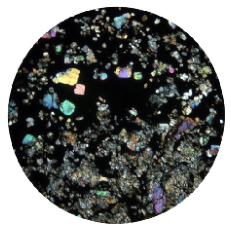

Prediction class: Non-Olivine, Softmax value: 0.06
**************************************************
thin_section_dataset/test/non-olivine/rbt04261_r1_basaltic_shergottite_olivine_pyroxene_maskelynite_glass_NOLV.jpg


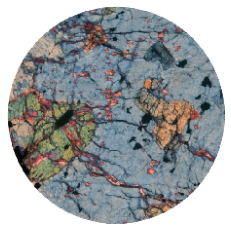

Prediction class: Olivine, Softmax value: 0.58
**************************************************
thin_section_dataset/test/non-olivine/s339_01_r1_basalt_pyroxene_olivine_iron_oxide_NOLV.jpg


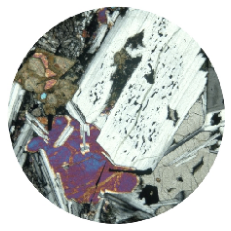

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/s339_06_r3_basalt_olivine_pyroxene_plagioclase_feldspar_iron_oxide_NOLV.jpg


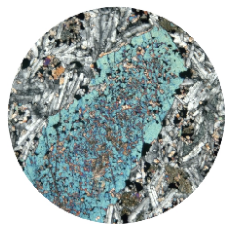

Prediction class: Olivine, Softmax value: 0.59
**************************************************
thin_section_dataset/test/non-olivine/shergotty_r1_basaltic_shergottite_pyroxene_olivine_maskelynite_glass_cristobalite_ilmenite_magnetite_pyrrhotite_apatite_whitlockite_amphibole_baddeleyite_fayalite_hercynite_majorite_NOLV.jpg


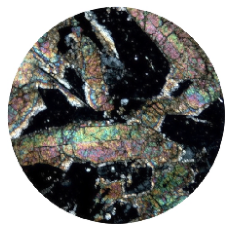

Prediction class: Non-Olivine, Softmax value: 0.25
**************************************************
thin_section_dataset/test/non-olivine/shergotty_r2_basaltic_shergottite_pyroxene_olivine_maskelynite_glass_cristobalite_ilmenite_magnetite_pyrrhotite_apatite_whitlockite_amphibole_baddeleyite_fayalite_hercynite_majorite_NOLV.jpg


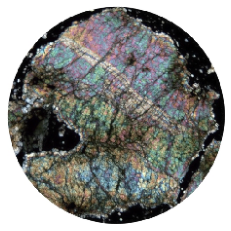

Prediction class: Non-Olivine, Softmax value: 0.43
**************************************************
thin_section_dataset/test/non-olivine/tc_p32000_r2_basalt_clinopyroxene_olivine_feldspar_magnetite_NOLV.jpg


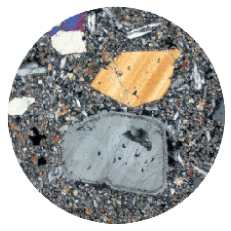

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/tc_p5546_r1_marble_calcite_dolomite_olivine_clinopyroxene_NOLV.jpg


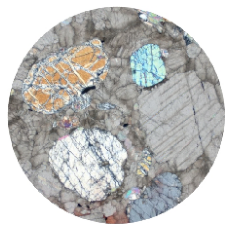

Prediction class: Olivine, Softmax value: 0.54
**************************************************
thin_section_dataset/test/non-olivine/tissint_r2_shergottite_achondrite_olivine_pyroxene_maskelynite_glass_chromite_merrillite_NOLV.jpg


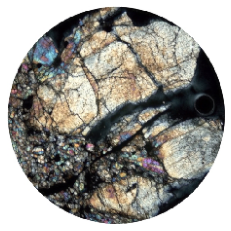

Prediction class: Non-Olivine, Softmax value: 0.43
**************************************************


In [127]:
predict_images(non_olivine_folder, base_model)

In [139]:
# entry point, run the test harness
# custom vgg model
custom_vgg_model, custom_vgg_history = run_test_harness(model_name='custom_vgg', epochs=50)

Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/50
16/16 [==============================] - 9s 565ms/step - loss: 1.8965 - accuracy: 0.4244 - val_loss: 0.6408 - val_accuracy: 0.7573
Epoch 2/50
16/16 [==============================] - 9s 546ms/step - loss: 1.3481 - accuracy: 0.4928 - val_loss: 0.6129 - val_accuracy: 0.7573
Epoch 3/50
16/16 [==============================] - 9s 547ms/step - loss: 1.1490 - accuracy: 0.5259 - val_loss: 0.7383 - val_accuracy: 0.2427
Epoch 4/50
16/16 [==============================] - 9s 544ms/step - loss: 1.0738 - accuracy: 0.5052 - val_loss: 0.6886 - val_accuracy: 0.7573
Epoch 5/50
16/16 [==============================] - 9s 558ms/step - loss: 1.0796 - accuracy: 0.4720 - val_loss: 0.6697 - val_accuracy: 0.7573
Epoch 6/50
16/16 [==============================] - 9s 536ms/step - loss: 1.0573 - accuracy: 

Found 104 images belonging to 2 classes.
104/104 [==============================] - 2s 16ms/step - loss: 0.6971 - accuracy: 0.2500

Accuracy on test set: 25.000


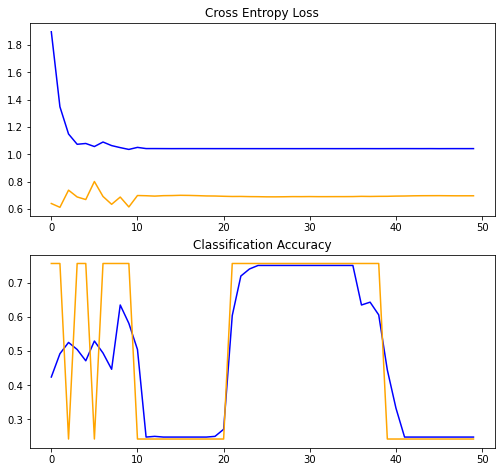

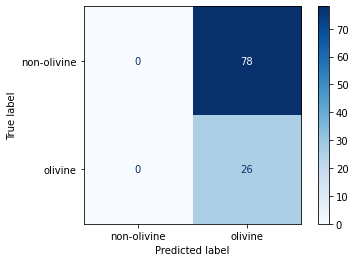

              precision    recall  f1-score   support

 non-olivine       0.00      0.00      0.00        78
     olivine       0.25      1.00      0.40        26

    accuracy                           0.25       104
   macro avg       0.12      0.50      0.20       104
weighted avg       0.06      0.25      0.10       104



C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [140]:
evaluate_model(custom_vgg_model, custom_vgg_history)

In [793]:
# entry point, run the test harness
# transfer learnin vgg model
vgg_model, vgg_history = run_test_harness(model_name='vgg', epochs=100, batch_size=32, index=22, verbose=1)

Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/100
16/16 [==============================] - 4s 248ms/step - loss: 1.9356 - accuracy: 0.6128 - val_loss: 0.5200 - val_accuracy: 0.8058
Epoch 2/100
16/16 [==============================] - 3s 208ms/step - loss: 0.8406 - accuracy: 0.7681 - val_loss: 0.4664 - val_accuracy: 0.7864
Epoch 3/100
16/16 [==============================] - 3s 207ms/step - loss: 0.5438 - accuracy: 0.8282 - val_loss: 0.4153 - val_accuracy: 0.8447
Epoch 4/100
16/16 [==============================] - 3s 206ms/step - loss: 0.3806 - accuracy: 0.9400 - val_loss: 0.4211 - val_accuracy: 0.7961
Epoch 5/100
16/16 [==============================] - 3s 206ms/step - loss: 0.3068 - accuracy: 0.9337 - val_loss: 0.4582 - val_accuracy: 0.7864
Epoch 6/100
16/16 [==============================] - 3s 206ms/step - loss: 0.2275 - accu

Found 104 images belonging to 2 classes.
104/104 [==============================] - 1s 12ms/step - loss: 0.7699 - accuracy: 0.7885

Accuracy on test set: 78.846


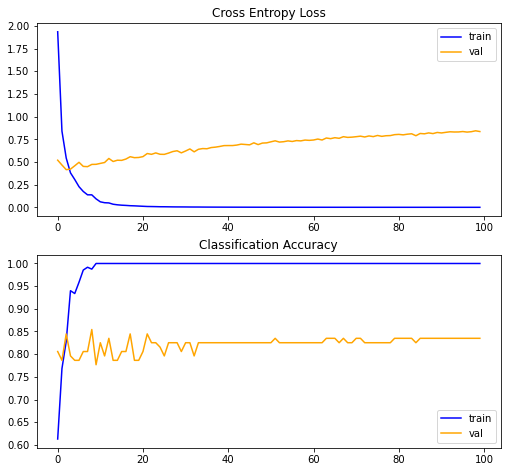

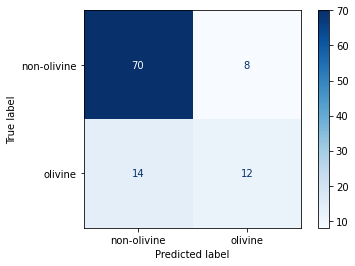

              precision    recall  f1-score   support

 non-olivine       0.83      0.90      0.86        78
     olivine       0.60      0.46      0.52        26

    accuracy                           0.79       104
   macro avg       0.72      0.68      0.69       104
weighted avg       0.77      0.79      0.78       104



0.7884615659713745

In [794]:
evaluate_model(vgg_model, vgg_history)

In [33]:
# resnet model
resnet_model, resnet_history = run_test_harness(model_name='resnet50', epochs=100, index=22, verbose=1)

Found 483 images belonging to 2 classes.
Found 103 images belonging to 2 classes.

Classes: {'non-olivine': 0, 'olivine': 1}
Class Weights: {0: 1.0, 1: 3.025}
Class Distribution: {0: 363, 1: 120}

Epoch 1/100
16/16 [==============================] - 4s 276ms/step - loss: 1.1215 - accuracy: 0.7081 - val_loss: 0.6931 - val_accuracy: 0.7573
Epoch 2/100
16/16 [==============================] - 3s 196ms/step - loss: 1.0419 - accuracy: 0.7516 - val_loss: 0.6931 - val_accuracy: 0.7573
Epoch 3/100
16/16 [==============================] - 3s 198ms/step - loss: 1.0419 - accuracy: 0.7516 - val_loss: 0.6931 - val_accuracy: 0.7573
Epoch 4/100
16/16 [==============================] - 3s 197ms/step - loss: 1.0419 - accuracy: 0.7516 - val_loss: 0.6931 - val_accuracy: 0.7573
Epoch 5/100
16/16 [==============================] - 3s 196ms/step - loss: 1.0419 - accuracy: 0.7516 - val_loss: 0.6931 - val_accuracy: 0.7573
Epoch 6/100
16/16 [==============================] - 3s 197ms/step - loss: 1.0419 - accu

Found 104 images belonging to 2 classes.
104/104 [==============================] - 2s 15ms/step - loss: 0.6931 - accuracy: 0.7500

Accuracy on test set: 75.000


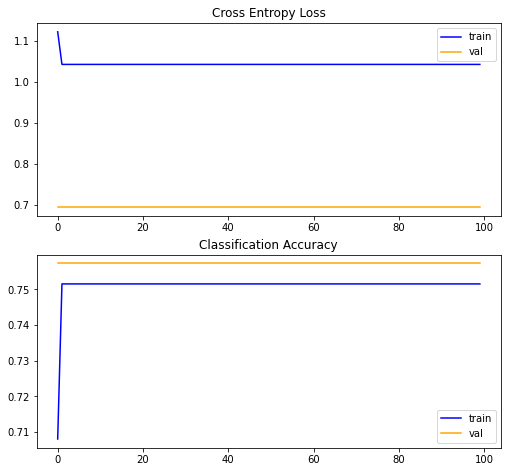

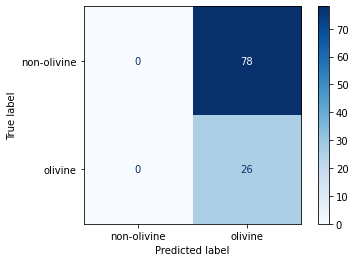

              precision    recall  f1-score   support

 non-olivine       0.00      0.00      0.00        78
     olivine       0.25      1.00      0.40        26

    accuracy                           0.25       104
   macro avg       0.12      0.50      0.20       104
weighted avg       0.06      0.25      0.10       104



C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jlewe\anaconda3\envs\ESA_37\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.75

In [34]:
evaluate_model(resnet_model, resnet_history)

## Grad Cam

In [25]:
def get_img_array(img_path, size):
    # `img` is a PIL image of size 224x224
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=size)
    # `array` is a float32 Numpy array of shape (224, 224, 3)
    array = tf.keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 224, 224, 3)
    array = np.expand_dims(array, axis=0)
    return array

In [26]:
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [27]:
def get_superimposed_gradcam_img(img, heatmap, cam_path="cam.jpg", alpha=0.8):
    # Load the original image
    #img = keras.preprocessing.image.load_img(img_path)
    img = img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = array_to_img(superimposed_img)
    
    # Save the superimposed image
    # superimposed_img.save(cam_path)

    # Display Grad CAM
    #display(Image(cam_path))
    #show(superimposed_img)
    
    return superimposed_img

In [28]:
def cam_display(display, text, src_img, superimposed_img, img_name, preds):
    text = f'IMG_NAME: {img_name}\nPrediction: {preds}'
    images = [src_img, superimposed_img]
    
    widths, heights = zip(*(i.size for i in images))
    
    total_width = sum(widths)
    max_height = max(heights)

    new_img = PIL.Image.new('RGB', (total_width, max_height))
    
    x_offset = 0
    for im in images:
        new_img.paste(im, (x_offset,0))
        x_offset += im.size[0]
    new_img = ImageOps.expand(new_img, border=50, fill=(255,255,255))
    new_img = new_img.resize(tuple(i*2 for i in new_img.size), resample=PIL.Image.BOX)
    draw = ImageDraw.Draw(new_img)
    font = ImageFont.truetype("FONTS/arial.ttf", 40)
    if text:
        draw.text((10,0),text,(0,0,0),font=font)
    if display:
        show_img(new_img)
    new_img.save(f'./cam_images/{img_name}')

In [29]:
def cam_pipeline(ROOT_DIR, img_name, json_img, IMAGE_SIZE, model_loaded, last_conv_layer_name, display=True, text=True):
    img_path = os.path.join(ROOT_DIR, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, IMAGE_SIZE)
    img = PIL.Image.fromarray(img)
    
    # Prepare image for class prediction
    img_array = get_img_array(img_path, size=IMAGE_SIZE)
    # Remove last layer's softmax
    model_loaded.layers[-1].activation = None
    
    # Print what the top predicted class is
    
    new_image = load_image(img_path, show=False)

    # check prediction
    # pred = model.predict(new_image)
    preds = model_loaded.predict(new_image)
    #print("Predicted:", decode_predictions(preds, top=1)[0])
    
    # Generate class activation heatmap
    heatmap = generate_gradcam_heatmap(img_array, model_loaded, last_conv_layer_name)
    superimposed_img = get_superimposed_gradcam_img(img, heatmap)
    
    json_img = json_img.resize(IMAGE_SIZE, PIL.Image.ANTIALIAS)
    
    cam_display(display, text, json_img, superimposed_img, img_name, preds)
    return heatmap

In [30]:
def get_img_and_draw(ROOT_DIR, img_name, IMAGE_SIZE):
    img_path = os.path.join(ROOT_DIR, img_name)
    print(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #img = cv2.resize(img, IMAGE_SIZE)
    img = PIL.Image.fromarray(img)
    draw = ImageDraw.Draw(img)
    return img, draw

In [31]:
def get_json_img_name(json_file_name):
    if ('_OLV' not in json_file_name):
        img_name = f"{json_file_name.split('.')[0]}_OLV.jpg"
    else:
        img_name = f"{json_file_name.split('.')[0]}.jpg"
    return img_name

In [32]:
def draw_json_polygons(img_name, json_file_name, ROOT_DIR, IMAGE_SIZE):    
    img, draw = get_img_and_draw(ROOT_DIR, img_name, IMAGE_SIZE)
    
    # Opening JSON file
    json_path = os.path.join(JSON_DIR, json_file_name)
    with open(json_path) as json_file:
        json_data = json.load(json_file)

    # iterate over all olivine polygons
    num_of_polygons = len(json_data['shapes'])
    for i in range(num_of_polygons): # iterate over different olivine crystals
        polygon_coordinates = [tuple(x) for x in json_data['shapes'][i]['points']]
        # print(polygon_coordinates)
        polygon_coordinates.append(polygon_coordinates[0]) # polygon needs to be closed
        for j in range(len(polygon_coordinates)-1): # iterate over coordinates of single crystal
            draw.line(polygon_coordinates[j] + polygon_coordinates[j+1], fill='red', width=3)
    return img

In [33]:
def calc_iou_score(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    print(f"IoU score: {iou_score:.2f}")
    return iou_score

./Olivine_Images/12004_r2_olivine_basalt_OLV.jpg


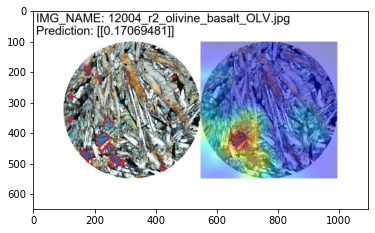

IoU score: 0.64
./Olivine_Images/12012_r2_olivine_basalt_OLV.jpg


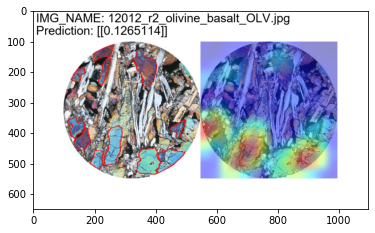

IoU score: 0.90
./Olivine_Images/12015_r1_olivine_vitrophyre_OLV.jpg


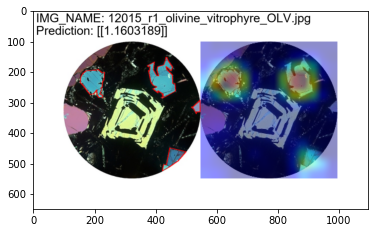

IoU score: 0.54
./Olivine_Images/12015_r2_olivine_vitrophyre_OLV.jpg


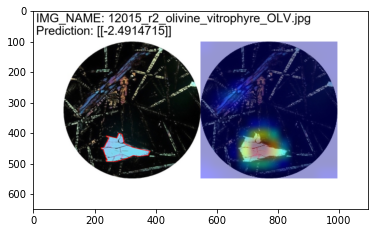

IoU score: 0.33
./Olivine_Images/12035_r1_olivine_basalt_OLV.jpg


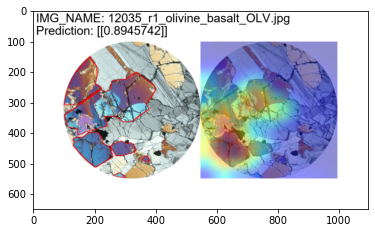

IoU score: 0.74
./Olivine_Images/12036_r1_olivine_basalt_OLV.jpg


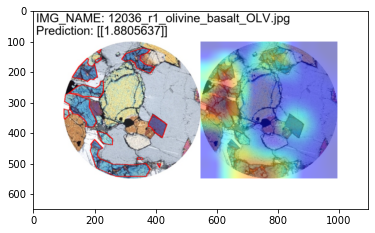

IoU score: 0.82
./Olivine_Images/12040_r2_olivine_basalt_OLV.jpg


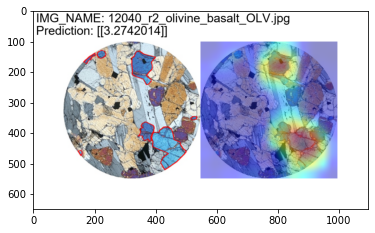

IoU score: 0.70
./Olivine_Images/12075_r2_olivine_basalt_OLV.jpg


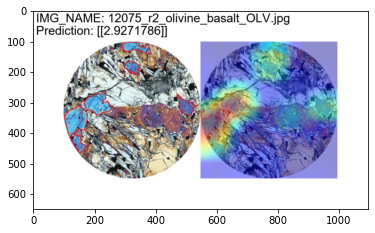

IoU score: 0.57
./Olivine_Images/12076_r2_olivine_basalt_OLV.jpg


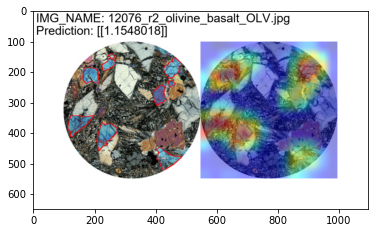

IoU score: 0.86
./Olivine_Images/14066_r2_crystalline_breccia_OLV.jpg


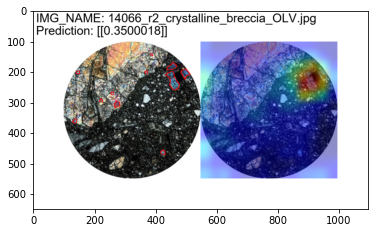

IoU score: 0.64
./Olivine_Images/14074_r2_basalt_OLV.jpg


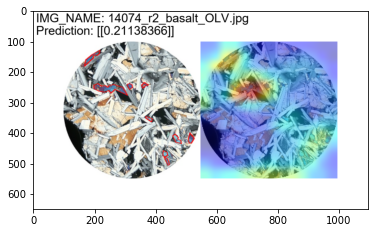

IoU score: 0.58
./Olivine_Images/14305_r2_polymict_breccia_OLV.jpg


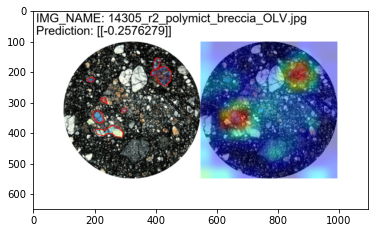

IoU score: 0.50
./Olivine_Images/14314_r1_crystalline_matrix_breccia_OLV.jpg


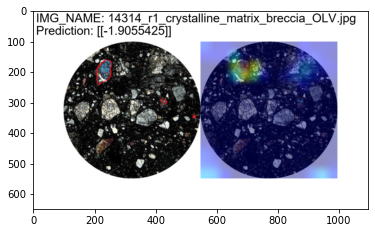

IoU score: 0.15
./Olivine_Images/15016_r1_vesicular_olivine_basalt_OLV.jpg


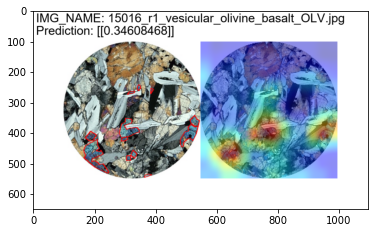

IoU score: 0.64
./Olivine_Images/15065_r1_pigeonite_basalt_OLV.jpg


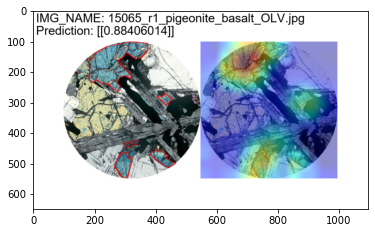

IoU score: 0.68
./Olivine_Images/15105_r2_olivine_phyric_basalt_OLV.jpg


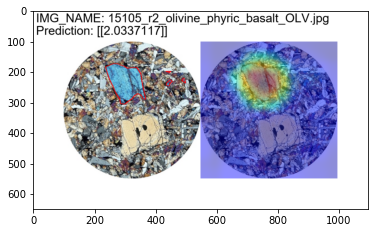

IoU score: 0.40
./Olivine_Images/15125_r1_vitrophyric_pigeonite_basalt_OLV.jpg


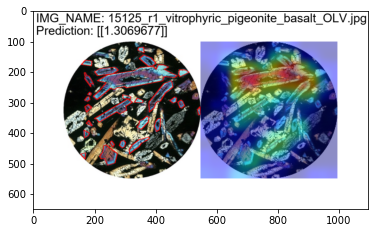

IoU score: 0.88
./Olivine_Images/15356_r1_impact_melt_OLV.jpg


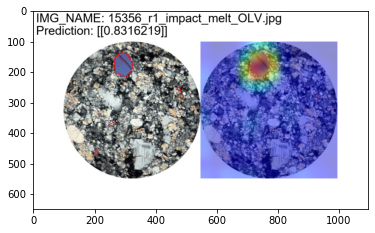

IoU score: 0.44
./Olivine_Images/15379_r1_shocked_olivine_basalt_OLV.jpg


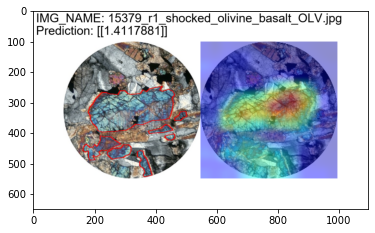

IoU score: 0.69
./Olivine_Images/15380_r2_shocked_olivine_basalt_OLV.jpg


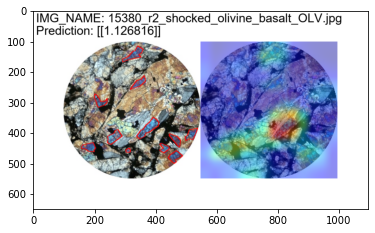

IoU score: 0.73
./Olivine_Images/15536_r1_olivine_basalt_OLV.jpg


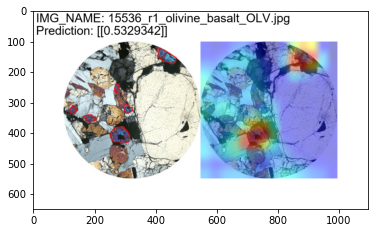

IoU score: 0.49
./Olivine_Images/15536_r2_olivine_basalt_OLV.jpg


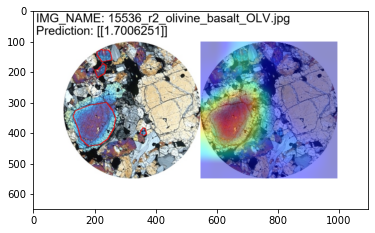

IoU score: 0.52
./Olivine_Images/15545_r2_olivine_basalt_OLV.jpg


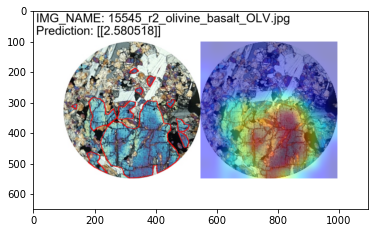

IoU score: 0.79
./Olivine_Images/15555_r1_olivine_basalt_OLV.jpg


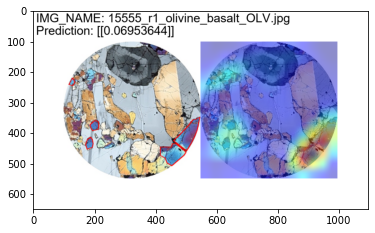

IoU score: 0.47
./Olivine_Images/15555_r2_olivine_basalt_OLV.jpg


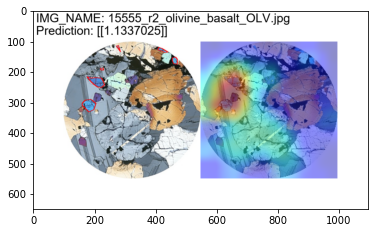

IoU score: 0.39
./Olivine_Images/15556_r1_vesicular_olivine_basalt_OLV.jpg


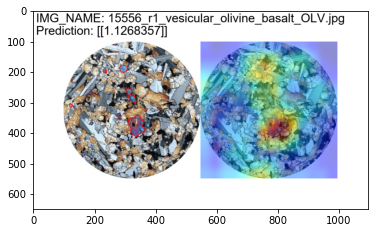

IoU score: 0.42
./Olivine_Images/15558_r1_regolith_breccia_OLV.jpg


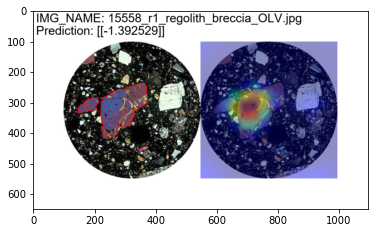

IoU score: 0.25
./Olivine_Images/15558_r2_regolith_breccia_OLV.jpg


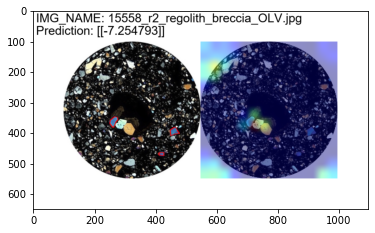

IoU score: 0.06
./Olivine_Images/15606_r1_olivine_basalt_OLV.jpg


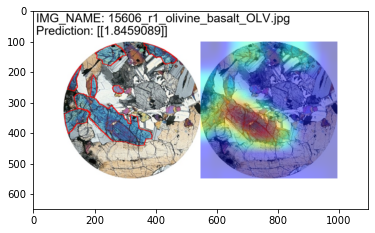

IoU score: 0.72
./Olivine_Images/15610_r1_coarse_olivine_basalt_OLV.jpg


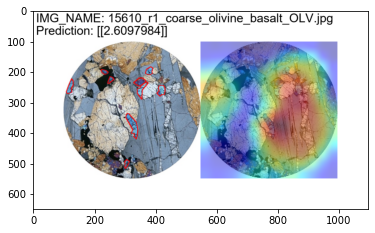

IoU score: 0.56
./Olivine_Images/15610_r2_coarse_olivine_basalt_OLV.jpg


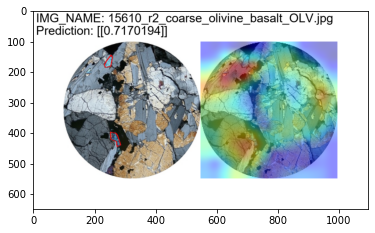

IoU score: 0.27
./Olivine_Images/15614_r1_vesicular_olivine_basalt_OLV.jpg


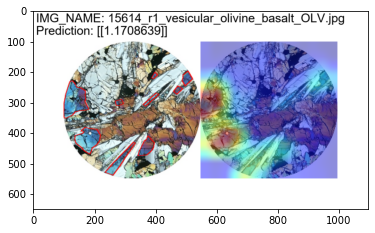

IoU score: 0.74
./Olivine_Images/15623_r1_vesicular_olivine_basalt_OLV.jpg


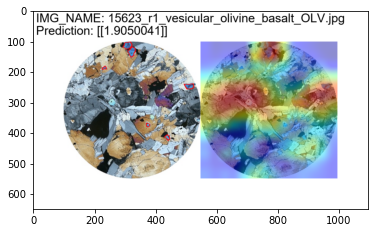

IoU score: 0.43
./Olivine_Images/15623_r2_vesicular_olivine_basalt_OLV.jpg


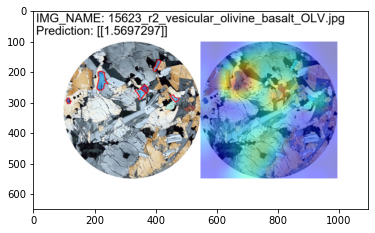

IoU score: 0.46
./Olivine_Images/15636_r2_olivine_basalt_OLV.jpg


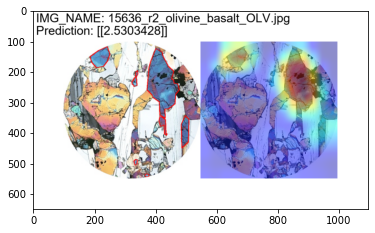

IoU score: 0.68
./Olivine_Images/15641_r1_coarse_olivine_basalt_OLV.jpg


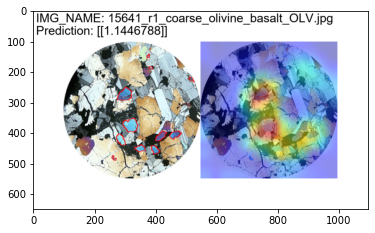

IoU score: 0.66
./Olivine_Images/15641_r2_coarse_olivine_basalt_OLV.jpg


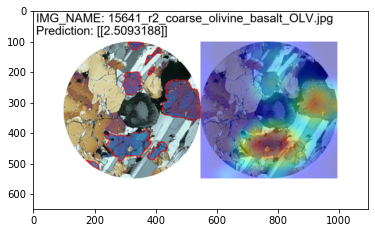

IoU score: 0.78
./Olivine_Images/15643_r2_coarse_olivine_basalt_OLV.jpg


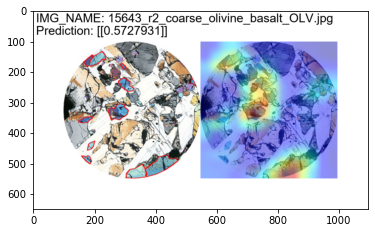

IoU score: 0.77
./Olivine_Images/15663_r2_coarse_olivine_basalt_OLV.jpg


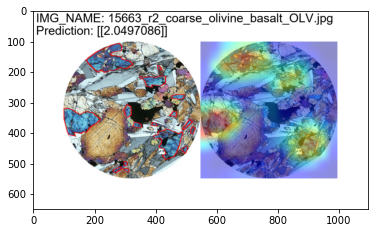

IoU score: 0.93
./Olivine_Images/15665_r2_olivine_basalt_OLV.jpg


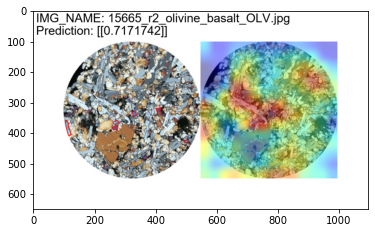

IoU score: 0.39
./Olivine_Images/67016_r1_immature_feldspathic_regolith_breccia_OLV.jpg


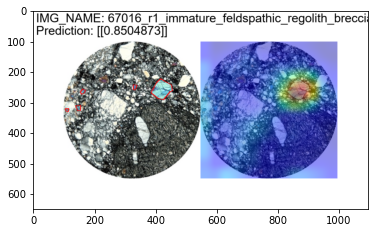

IoU score: 0.36
./Olivine_Images/dg01_r3_basalt_pyroxene_olivine_pumpellyite_plagioclase_feldspar_OLV.jpg


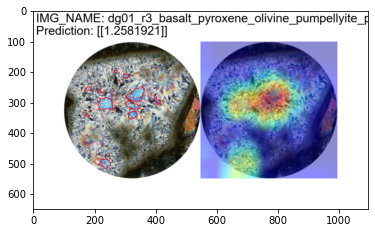

IoU score: 0.56
./Olivine_Images/jrs005_r1_pyroxene_olivine_plagioclase_feldspar_OLV.jpg


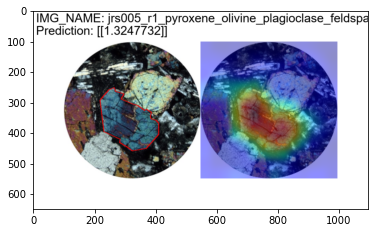

IoU score: 0.45
./Olivine_Images/jrs005_r2_pyroxene_olivine_plagioclase_feldspar_OLV.jpg


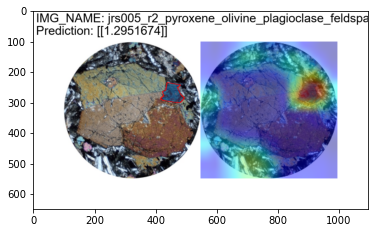

IoU score: 0.18
./Olivine_Images/p5151_r2_olivine_OLV.jpg


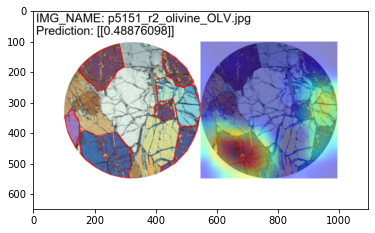

IoU score: 0.99
./Olivine_Images/rbt04262_r1_Martian_meteorites_pyroxene_olivine_maskelynite_glass_OLV.jpg


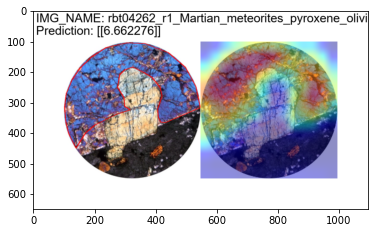

IoU score: 0.79
./Olivine_Images/smg095_r2_basalt_olivine_pyroxene_plagioclase_feldspar_apatite_iron_oxide_OLV.jpg


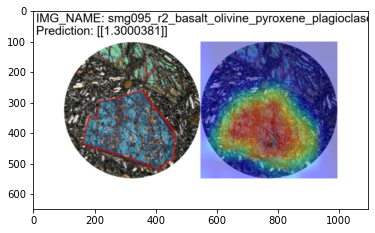

IoU score: 0.64
./Olivine_Images/smg117_r1_peridotite_olivine_pyroxene_chromite_plagioclase_feldspar_OLV.jpg


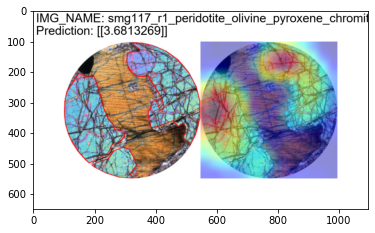

IoU score: 0.91


In [41]:
JSON_DIR = "./olivine_polygon_label_files/"
ROOT_DIR = "./Olivine_Images/"
heatmap_size = (14, 14)
# heatmap_size = (56, 56)
IMAGE_SIZE = (224,224)
#for fname in os.listdir('./saved_models/best_iou'):
#    if fname.endswith('.h5'):
#        model_loaded = load_model(f'./saved_models/best_iou/{fname}')
#    else:
#        print("No model found...")
model_loaded = load_model("./saved_models/best_iou/base/base_model_iou_0.5850_.h5")
# last_conv_layer_name = "block5_conv3"
last_conv_layer_name = "last_conv_layer"
json_files = os.listdir(JSON_DIR)
true_label_folder = "./data_dataset_voc/SegmentationClass"
iou_scores = []

for json_file_name in json_files:
    img_name = get_json_img_name(json_file_name)
    image_id = "_".join(img_name.split('_')[:3])
    json_img = draw_json_polygons(img_name, json_file_name, ROOT_DIR, IMAGE_SIZE)
    #show_img(json_img)
    pred_heatmap = cam_pipeline(ROOT_DIR, img_name, json_img, IMAGE_SIZE, model_loaded, last_conv_layer_name, display=True, text=False)
    predicted_binary_heatmap = np.where(pred_heatmap > 0.01, 1, 0)
    # search for corresponding labeled .npy file:
    for file in os.listdir(true_label_folder):
        if image_id in file:
            ground_truth_heatmap = np.load(os.path.join(true_label_folder, file))
            ground_truth_heatmap = resize(ground_truth_heatmap, heatmap_size)
            iou_score = calc_iou_score(ground_truth_heatmap, predicted_binary_heatmap)
            iou_scores.append(iou_score)

In [38]:
print(f"Mean IoU score: {np.mean(iou_scores):.2f}")
print(f"STD of IoU scores: {np.std(iou_scores):.2f}")
print(f"Max IoU score: {np.max(iou_scores):.2f}")
print(f"Min IoU score: {np.min(iou_scores):.2f}")

Mean IoU score: 0.31
STD of IoU scores: 0.13
Max IoU score: 0.54
Min IoU score: 0.04


In [755]:
# load .npy file
ground_truth_label = "./data_dataset_voc/SegmentationClass/smg117_r1_peridotite_olivine_pyroxene_chromite_plagioclase_feldspar_OLV.npy"
ground_truth_heatmap = np.load(ground_truth_label)
from skimage.transform import resize
ground_truth_heatmap = resize(ground_truth_heatmap, (56, 56))
#ground_truth_heatmap = np.where(ground_truth_heatmap > 0, 1, -1)
#labeled_heatmap = np.resize(labeled_heatmap, (56, 56))

In [781]:
np.mean([1,2,3])

2.0